In [10]:
#!/usr/bin/env python

In [2]:
import pandas as pd
import numpy as np

In [3]:
health = pd.read_csv("../Datasets/rankmd.csv", delimiter=";")
FastFood = pd.read_csv("../Datasets/FastFoodRestaurants.csv")
income = pd.read_csv("../Datasets/kaggle_income.csv", encoding="ISO 8859-1")

In [17]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import sys
#!{sys.executable} -m pip install folium
import folium

lat, lon = 37.77919, -100.41914 

map_SF = folium.Map([lat, lon], tiles = "Stamen Toner", zoom_start=4)


lat_list = list(FastFood.latitude)
lon_list = list(FastFood.longitude)

for i in range(len(FastFood)):
    folium.CircleMarker(location=[lat_list[i], lon_list[i]],
                        color='red',
                        radius=1,
                        weight=1).add_to(map_SF)


map_SF

In [5]:
health['FIPS']=health['FIPS'].apply(lambda x: '{0:0>5}'.format(x))
health

,FIPS,State,County,Unreliable,premature_deathDeaths,premature_deathYears_of_Potential_Life_Lost_Rate,premature_death_95% CILow,premature_death_95% CI - High,premature_death_Quartile,premature_death_YPLL Rate (AIAN),...,drive_alone_to_work_% Drive Alone (Hispanic) 95% CI - High,drive_alone_to_work_% Drive Alone (White),drive_alone_to_work_% Drive Alone (White) 95% CI - Low,drive_alone_to_work_% Drive Alone (White) 95% CI - High,long_commute_driving_alone_# Workers who Drive Alone,long_commute_driving_alone_% Long Commute - Drives Alone,long_commute_driving_alone_95% CI - Low,long_commute_driving_alone_95% CI - High,long_commute_driving_alone_Quartile,Unnamed: 249
0,01000,Alabama,NaN,NaN,82249.0,9820.0,9718.0,9922.0,NaN,5145.0,...,78.0,87.0,87.0,87.0,2073072,35,34,35,NaN,NaN
1,01001,Alabama,Autauga,NaN,787.0,7830.0,6998.0,8662.0,1.0,NaN,...,NaN,82.0,78.0,87.0,24635,38,34,42,2.0,NaN
2,01003,Alabama,Baldwin,NaN,3147.0,7680.0,7237.0,8124.0,1.0,NaN,...,83.0,82.0,80.0,84.0,93141,40,38,43,3.0,NaN
3,01005,Alabama,Barbour,NaN,515.0,11477.0,9908.0,13045.0,3.0,NaN,...,NaN,86.0,82.0,91.0,8231,31,26,36,2.0,NaN
4,01007,Alabama,Bibb,NaN,476.0,12173.0,10506.0,13839.0,4.0,NaN,...,NaN,NaN,NaN,NaN,8167,52,44,60,4.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3188,56037,Wyoming,Sweetwater,NaN,527.0,7775.0,6849.0,8701.0,3.0,NaN,...,67.0,77.0,75.0,79.0,21188,17,14,19,2.0,NaN
3189,56039,Wyoming,Teton,NaN,109.0,2980.0,2094.0,3866.0,1.0,NaN,...,76.0,67.0,63.0,71.0,14096,16,11,21,2.0,NaN
3190,56041,Wyoming,Uinta,NaN,271.0,8081.0,6637.0,9525.0,4.0,NaN,...,NaN,NaN,NaN,NaN,9155,20,15,24,3.0,NaN
3191,56043,Wyoming,Washakie,NaN,104.0,6541.0,4417.0,8665.0,2.0,NaN,...,NaN,NaN,NaN,NaN,3663,7,4,10,1.0,NaN


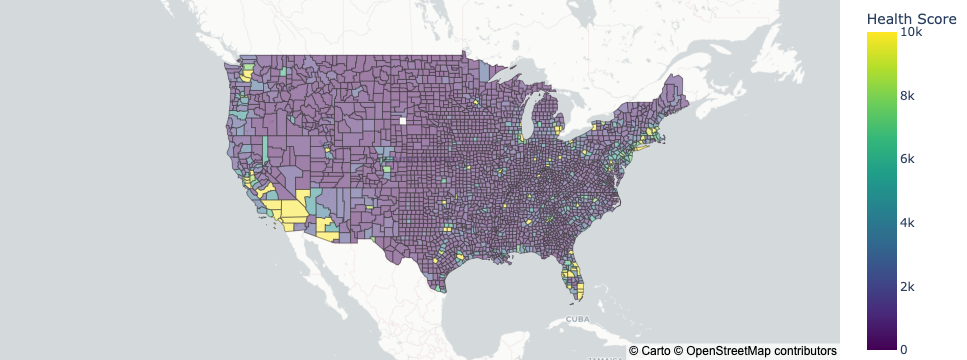

In [7]:
from urllib.request import urlopen
import json
import os
#!{sys.executable} -m pip install geopandas
import pandas as pd
import geopandas as gpd
import plotly.express as px
#df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
 #dtype={"fips": str})

from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)


fig = px.choropleth_mapbox(health.fillna(0), geojson=counties, locations='FIPS', color='premature_deathDeaths',
                           color_continuous_scale="Viridis",
                           range_color=(0, 10000),
                           mapbox_style="carto-positron",
                           zoom=2.5, center = {"lat": 37.77919, "lon": -100.41914},
                           opacity=0.5,
                           labels={'premature_deathDeaths':'Health Score'}
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

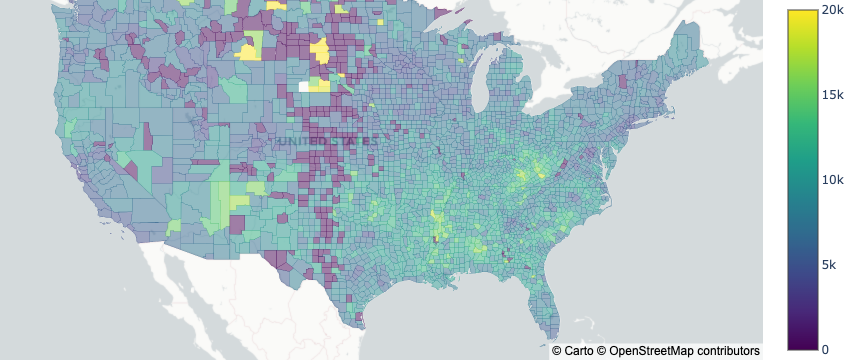

In [20]:
import plotly.graph_objects as go

fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=health.FIPS, z=health.premature_deathYears_of_Potential_Life_Lost_Rate.fillna(0),
                                    colorscale="Viridis", zmin=0, zmax=20000,
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [21]:
income

,id,State_Code,State_Name,State_ab,County,City,Place,Type,Primary,Zip_Code,Area_Code,ALand,AWater,Lat,Lon,Mean,Median,Stdev,sum_w
0,1011000,1,Alabama,AL,Mobile County,Chickasaw,Chickasaw city,City,place,36611,251,10894952,909156,30.771450,-88.079697,38773,30506,33101,1638.260513
1,1011010,1,Alabama,AL,Barbour County,Louisville,Clio city,City,place,36048,334,26070325,23254,31.708516,-85.611039,37725,19528,43789,258.017685
2,1011020,1,Alabama,AL,Shelby County,Columbiana,Columbiana city,City,place,35051,205,44835274,261034,33.191452,-86.615618,54606,31930,57348,926.031000
3,1011030,1,Alabama,AL,Mobile County,Satsuma,Creola city,City,place,36572,251,36878729,2374530,30.874343,-88.009442,63919,52814,47707,378.114619
4,1011040,1,Alabama,AL,Mobile County,Dauphin Island,Dauphin Island,Town,place,36528,251,16204185,413605152,30.250913,-88.171268,77948,67225,54270,282.320328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32521,720296,72,Puerto Rico,PR,Adjuntas Municipio,Guaynabo,Adjuntas,Track,Track,970,787,589417,1691,18.397925,-66.130633,30649,13729,37977,1321.278082
32522,7202966,72,Puerto Rico,PR,Adjuntas Municipio,Aguada,Adjuntas,Track,Track,602,787,1801613,795887,18.385424,-67.203310,15520,9923,15541,238.813450
32523,7202976,72,Puerto Rico,PR,Adjuntas Municipio,Aguada,Adjuntas,Track,Track,602,787,11031227,0,18.356565,-67.180686,41933,34054,31539,313.551070
32524,7202986,72,Puerto Rico,PR,Adjuntas Municipio,Aguada,Adjuntas,Track,Track,602,787,0,33597561,18.412041,-67.213413,0,0,0,0.000000


In [13]:
health

,FIPS,State,County,Unreliable,premature_deathDeaths,premature_deathYears_of_Potential_Life_Lost_Rate,premature_death_95% CILow,premature_death_95% CI - High,premature_death_Quartile,premature_death_YPLL Rate (AIAN),...,drive_alone_to_work_% Drive Alone (Hispanic) 95% CI - High,drive_alone_to_work_% Drive Alone (White),drive_alone_to_work_% Drive Alone (White) 95% CI - Low,drive_alone_to_work_% Drive Alone (White) 95% CI - High,long_commute_driving_alone_# Workers who Drive Alone,long_commute_driving_alone_% Long Commute - Drives Alone,long_commute_driving_alone_95% CI - Low,long_commute_driving_alone_95% CI - High,long_commute_driving_alone_Quartile,Unnamed: 249
0,1000,Alabama,NaN,NaN,82249.0,9820.0,9718.0,9922.0,NaN,5145.0,...,78.0,87.0,87.0,87.0,2073072,35,34,35,NaN,NaN
1,1001,Alabama,Autauga,NaN,787.0,7830.0,6998.0,8662.0,1.0,NaN,...,NaN,82.0,78.0,87.0,24635,38,34,42,2.0,NaN
2,1003,Alabama,Baldwin,NaN,3147.0,7680.0,7237.0,8124.0,1.0,NaN,...,83.0,82.0,80.0,84.0,93141,40,38,43,3.0,NaN
3,1005,Alabama,Barbour,NaN,515.0,11477.0,9908.0,13045.0,3.0,NaN,...,NaN,86.0,82.0,91.0,8231,31,26,36,2.0,NaN
4,1007,Alabama,Bibb,NaN,476.0,12173.0,10506.0,13839.0,4.0,NaN,...,NaN,NaN,NaN,NaN,8167,52,44,60,4.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3188,56037,Wyoming,Sweetwater,NaN,527.0,7775.0,6849.0,8701.0,3.0,NaN,...,67.0,77.0,75.0,79.0,21188,17,14,19,2.0,NaN
3189,56039,Wyoming,Teton,NaN,109.0,2980.0,2094.0,3866.0,1.0,NaN,...,76.0,67.0,63.0,71.0,14096,16,11,21,2.0,NaN
3190,56041,Wyoming,Uinta,NaN,271.0,8081.0,6637.0,9525.0,4.0,NaN,...,NaN,NaN,NaN,NaN,9155,20,15,24,3.0,NaN
3191,56043,Wyoming,Washakie,NaN,104.0,6541.0,4417.0,8665.0,2.0,NaN,...,NaN,NaN,NaN,NaN,3663,7,4,10,1.0,NaN
